# Dataset Integration

### Library loading

In [1]:
import scanpy as sc, anndata as ad, numpy as np, pandas as pd
from scipy import sparse
from anndata import AnnData
from matplotlib import pylab
import warnings
import socket
import yaml
import matplotlib as plt


import scanpy.external as sce
import os
warnings.filterwarnings('ignore')

In [2]:
sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
with open("../data/resources/rcParams.yaml") as f:
    rcParamsDict = yaml.full_load(f)
    for k in rcParamsDict["rcParams"]:
        print("{} {}".format(k,rcParamsDict["rcParams"][k]))
        plt.rcParams[k] = rcParamsDict["rcParams"][k]
    for k1 in set(list(rcParamsDict)).difference(set(["rcParams"])):
        print("{} {}".format(k1,rcParamsDict[k1]))

scanpy==1.8.0 anndata==0.8.0 umap==0.4.6 numpy==1.22.2 scipy==1.6.2 pandas==1.2.3 scikit-learn==0.24.1 statsmodels==0.13.5 python-igraph==0.9.1 louvain==0.7.0 leidenalg==0.8.3
figure.dpi 80
savefig.dpi 500
figure.figsize [10, 10]
axes.facecolor white
dotSize 20


### Configure paths

In [3]:
outdir = "../data/output"


with open("../data/resources/iPSC_lines_map.yaml", 'r') as f:
    iPSC_lines_map = yaml.load(f, Loader=yaml.FullLoader)["lines"]

## Harmony

In [4]:
Multiplexing = sc.read_h5ad(outdir+"/adatas/MultiplexingPreprocessing_JoinScale.h5ad")

In [5]:
sc.tl.pca(Multiplexing, svd_solver='arpack')

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:08)


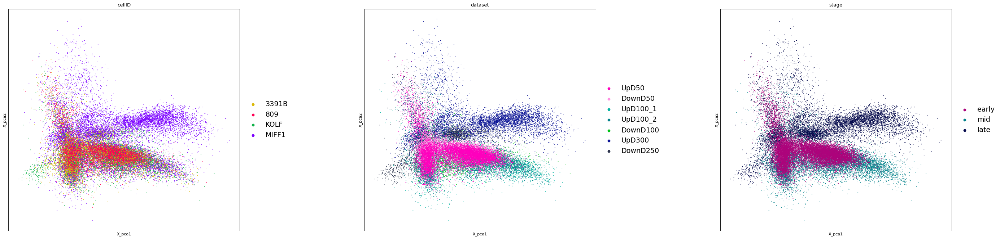

In [6]:
sc.pl.embedding(Multiplexing, "X_pca" ,color=["cellID_newName","dataset","stage"],ncols=3, size = 10, wspace=.4, legend_fontsize = "xx-large")

In [7]:
#sce.pp.harmony_integrate(Multiplexing, 'dataset', theta = 0, sigma= 0.1)
sce.pp.harmony_integrate(Multiplexing, 'dataset', adjusted_basis="X_pca",  max_iter_harmony=20)
#'X_pca_harmony' in Multiplexing.obsm

2023-07-23 18:06:19,119 - harmonypy - INFO - Iteration 1 of 20
2023-07-23 18:06:29,097 - harmonypy - INFO - Iteration 2 of 20
2023-07-23 18:06:39,241 - harmonypy - INFO - Converged after 2 iterations


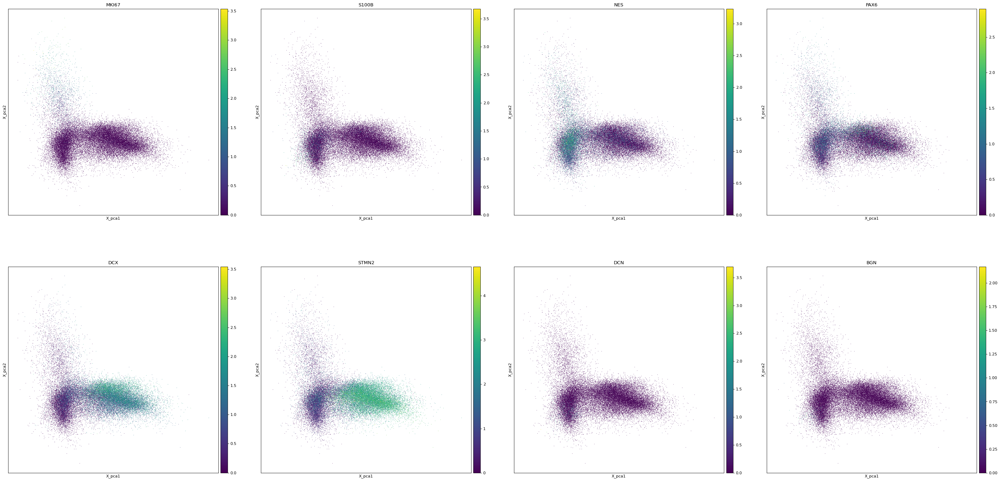

In [8]:
sc.pl.embedding(Multiplexing, "X_pca" ,color=['MKI67', 'S100B',"NES","PAX6","DCX",'STMN2',"DCN", "BGN"])

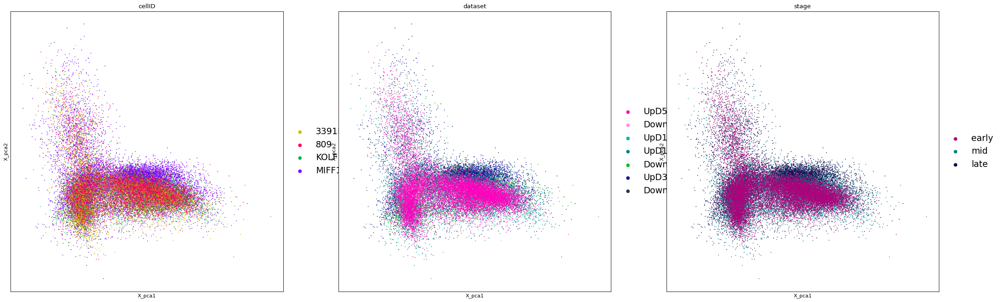

In [9]:
sc.pl.embedding(Multiplexing, "X_pca" ,color=["cellID_newName","dataset","stage"],ncols=3, size = 10, legend_fontsize = "xx-large")

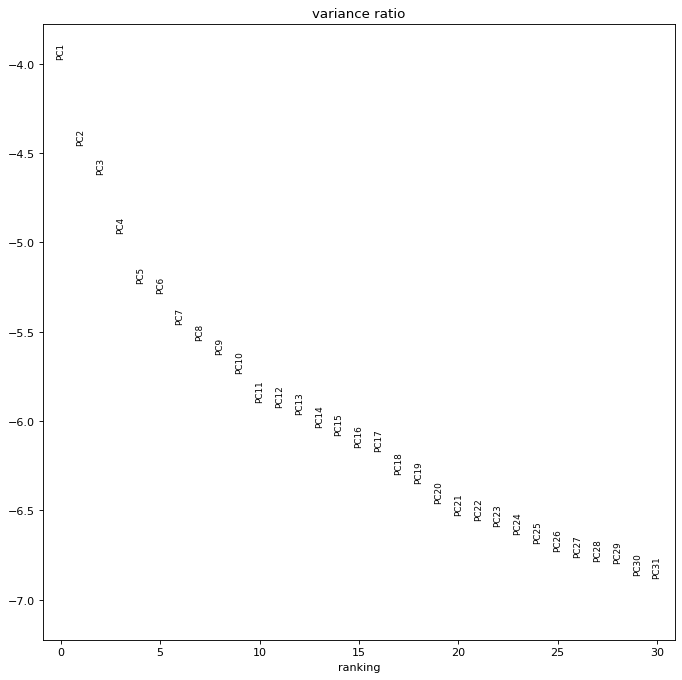

In [10]:
test = Multiplexing

test.obsm["X_pca"] = test.obsm["X_pca"]
sc.pl.pca_variance_ratio(test, log=True)
del test

### Neighbors

In [11]:
sc.pp.neighbors(Multiplexing,use_rep="X_pca",n_neighbors=100, n_pcs=15)

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:49)


### leiden

In [12]:
sc.tl.leiden(Multiplexing, resolution=5, key_added="leiden_5")

running Leiden clustering
    finished: found 50 clusters and added
    'leiden_5', the cluster labels (adata.obs, categorical) (0:00:33)


### UMAP

In [13]:
sc.tl.umap(Multiplexing)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:34)


#### Allmarkers

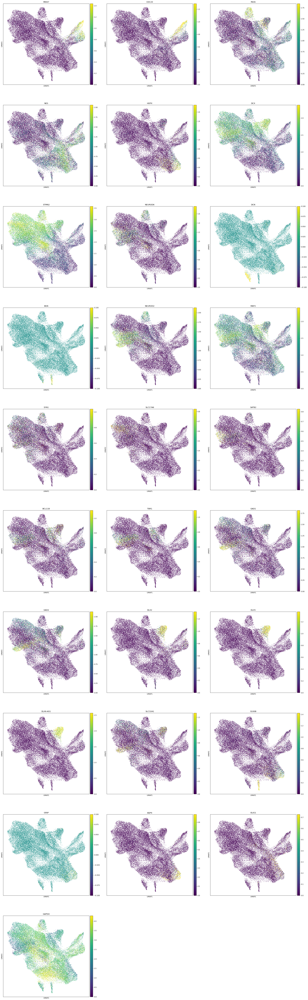

In [14]:
genes = pd.array(["MKI67","CDC20","PAX6","NES","HOPX","DCX","STMN2","NEUROD6","DCN", "BGN","NEUROD2","MAP2","SYN1","SLC17A6", "SATB2","BCL11B","TBR1", "GAD1","GAD2","DLX2","DLX5","DLX6-AS1","SLC32A1","S100B", "GFAP", "AQP4", "OLIG1", "GAPDH"], dtype="category")
sc.pl.umap(Multiplexing,color= genes[genes.isin(Multiplexing.var_names) ],size = 10, ncols=3, vmin='p1.5',vmax='p98.5' )


### Diffmap

In [15]:
sc.tl.diffmap(Multiplexing)

computing Diffusion Maps using n_comps=15(=n_dcs)
computing transitions
    finished (0:00:00)
    eigenvalues of transition matrix
    [1.         0.9931962  0.9901007  0.98139846 0.9763207  0.97453934
     0.97297174 0.96822673 0.9666156  0.96510816 0.9564396  0.952581
     0.9507382  0.94528705 0.93689126]
    finished: added
    'X_diffmap', diffmap coordinates (adata.obsm)
    'diffmap_evals', eigenvalues of transition matrix (adata.uns) (0:00:04)


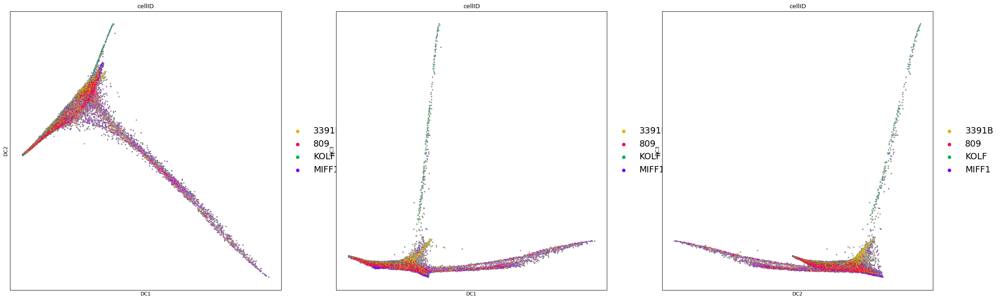

In [16]:
sc.pl.diffmap(Multiplexing, color= "cellID_newName", components=['1,2','1,3','2,3'], size = 10,add_outline=True, outline_width=(0.2, 0.05), legend_fontsize = "xx-large")


In [17]:
Multiplexing.write_h5ad(outdir+"/adatas/Integration_HarmonyAll.h5ad")

In [18]:
Multiplexing

AnnData object with n_obs × n_vars = 34249 × 3499
    obs: 'dataset', 'cellID', 'cellID_newName', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'stage', 'type', 'id_stage', 'cellID_newName_type', 'leiden_5'
    var: 'highly_variable', 'mean', 'std'
    uns: 'cellID_colors', 'cellID_newName_colors', 'cellID_newName_type_colors', 'dataset_colors', 'stage_colors', 'type_colors', 'pca', 'neighbors', 'leiden', 'umap', 'diffmap_evals'
    obsm: 'X_pca', 'X_umap', 'X_diffmap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

## Filtering out Proteoglycan

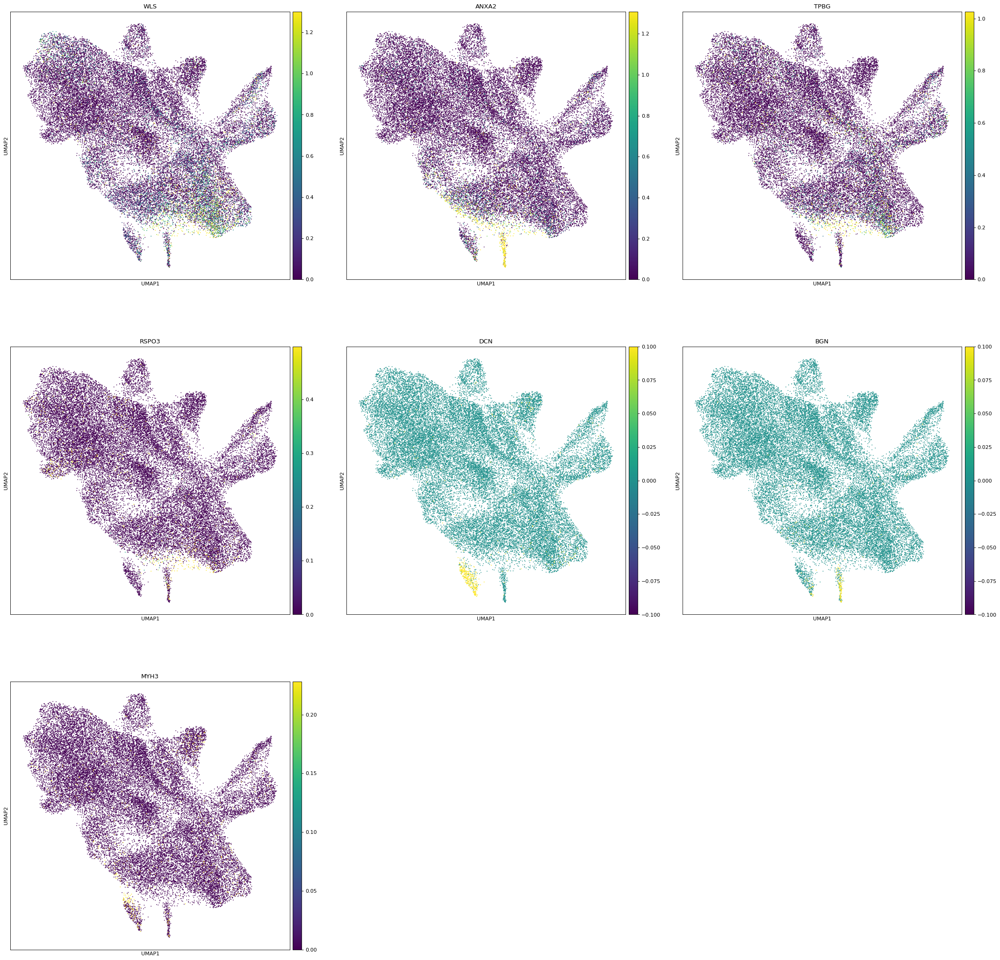

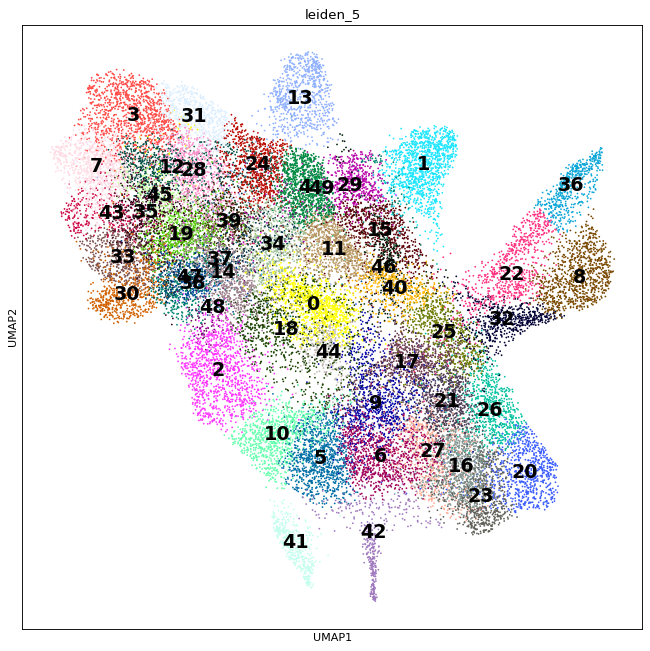

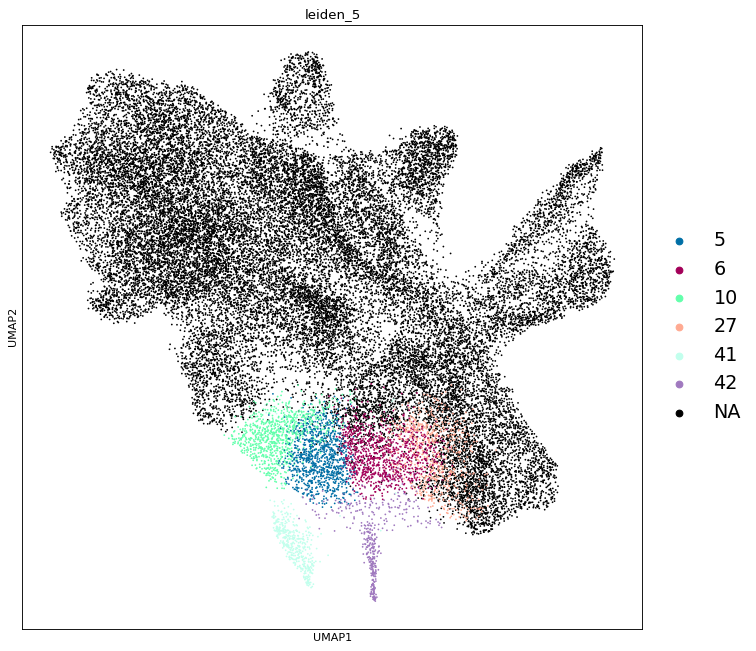

In [19]:
CellAdesion = pd.array(["WLS", "ANXA2","TPBG","RSPO3","DCN","BGN", "MYH3"], dtype="category")

sc.pl.umap(Multiplexing,color= CellAdesion[CellAdesion.isin(Multiplexing.var_names) ],size = 10, ncols=3, vmin='p1.5',vmax='p98.5' )
sc.pl.umap(Multiplexing, color=["leiden_5"], legend_loc="on data", size = 10, legend_fontsize = "xx-large")
sc.pl.umap(Multiplexing, color=['leiden_5'], groups=["42","41","5","27","6","10"],size = 10,add_outline=False, outline_width=(0.2, 0.05), na_color="black", legend_fontsize = "xx-large")

In [20]:
Multiplexing = sc.read(outdir+"/adatas/Integration_HarmonyAll.h5ad")
Multiplexing_filt = Multiplexing[-Multiplexing.obs['leiden_5'].isin(["42","41","5","27","6","10"])]

## Restarting from PCA 

In [21]:
Multiplexing_filt

View of AnnData object with n_obs × n_vars = 29914 × 3499
    obs: 'dataset', 'cellID', 'cellID_newName', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'stage', 'type', 'id_stage', 'cellID_newName_type', 'leiden_5'
    var: 'highly_variable', 'mean', 'std'
    uns: 'cellID_colors', 'cellID_newName_colors', 'cellID_newName_type_colors', 'dataset_colors', 'diffmap_evals', 'leiden', 'neighbors', 'pca', 'stage_colors', 'type_colors', 'umap'
    obsm: 'X_diffmap', 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [22]:
del Multiplexing_filt.obsm

del Multiplexing_filt.obs["leiden_5"]


del Multiplexing_filt.obsp
del Multiplexing_filt.varm

for unsKey in [k for k in list(Multiplexing_filt.uns.keys()) if "_colors"  not in k]:
    del Multiplexing_filt.uns[unsKey]

In [23]:
Multiplexing_filt

AnnData object with n_obs × n_vars = 29914 × 3499
    obs: 'dataset', 'cellID', 'cellID_newName', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'stage', 'type', 'id_stage', 'cellID_newName_type'
    var: 'highly_variable', 'mean', 'std'
    uns: 'cellID_colors', 'cellID_newName_colors', 'cellID_newName_type_colors', 'dataset_colors', 'stage_colors', 'type_colors'

In [24]:
sc.tl.pca(Multiplexing_filt)

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:12)


In [25]:
#sce.pp.harmony_integrate(Multiplexing, 'dataset', theta = 0, sigma= 0.1)
import scanpy.external as sce
sce.pp.harmony_integrate(Multiplexing_filt, 'dataset', max_iter_harmony=20, adjusted_basis="X_pca")
#'X_pca_harmony' in Multiplexing.obsm

2023-07-23 18:09:37,731 - harmonypy - INFO - Iteration 1 of 20
2023-07-23 18:09:45,820 - harmonypy - INFO - Iteration 2 of 20
2023-07-23 18:09:57,251 - harmonypy - INFO - Converged after 2 iterations


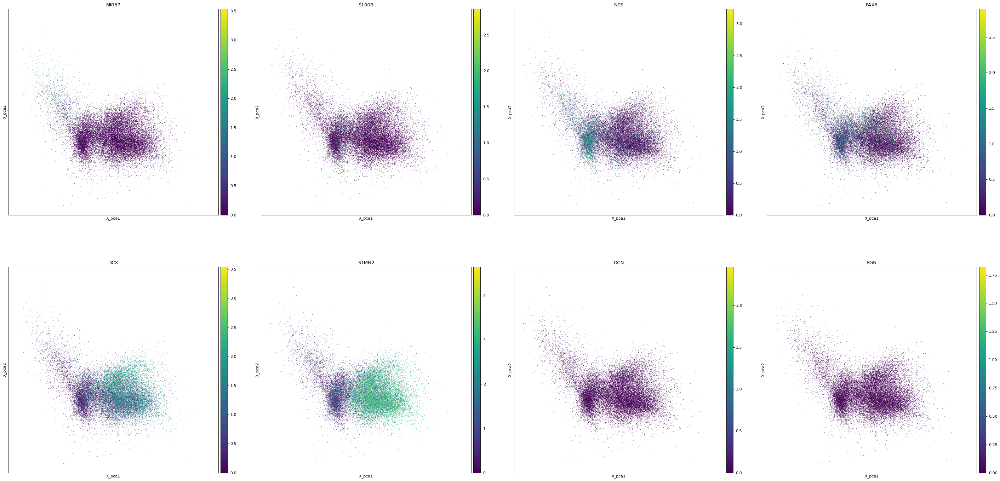

In [26]:
sc.pl.embedding(Multiplexing_filt, "X_pca" ,color=['MKI67', 'S100B',"NES","PAX6","DCX",'STMN2',"DCN", "BGN"])

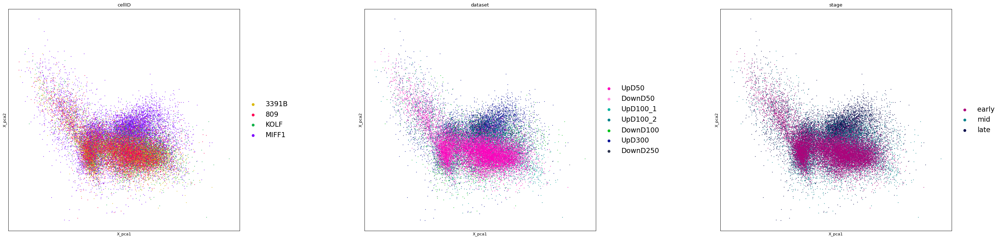

In [27]:
sc.pl.embedding(Multiplexing_filt, "X_pca" ,color=["cellID_newName","dataset","stage"],ncols=3, size = 10, wspace=.4, legend_fontsize = "xx-large")

In [28]:
Multiplexing_filt

AnnData object with n_obs × n_vars = 29914 × 3499
    obs: 'dataset', 'cellID', 'cellID_newName', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'stage', 'type', 'id_stage', 'cellID_newName_type'
    var: 'highly_variable', 'mean', 'std'
    uns: 'cellID_colors', 'cellID_newName_colors', 'cellID_newName_type_colors', 'dataset_colors', 'stage_colors', 'type_colors', 'pca'
    obsm: 'X_pca'
    varm: 'PCs'

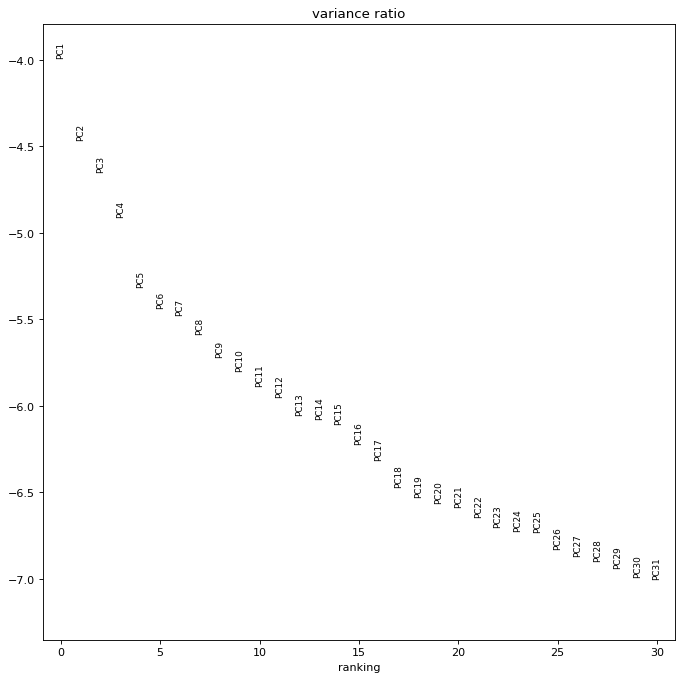

In [29]:
test = Multiplexing_filt.copy()

test.obsm["X_pca"] = test.obsm["X_pca"]
sc.pl.pca_variance_ratio(test, log=True)
del test

### Neighbors

In [30]:
sc.pp.neighbors(Multiplexing_filt,use_rep="X_pca",n_neighbors=100, n_pcs=15)

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:39)


In [31]:
sc.tl.leiden(Multiplexing_filt, resolution=1)

running Leiden clustering
    finished: found 16 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:22)


### UMAP

In [32]:
sc.tl.umap(Multiplexing_filt)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:29)


#### general markers

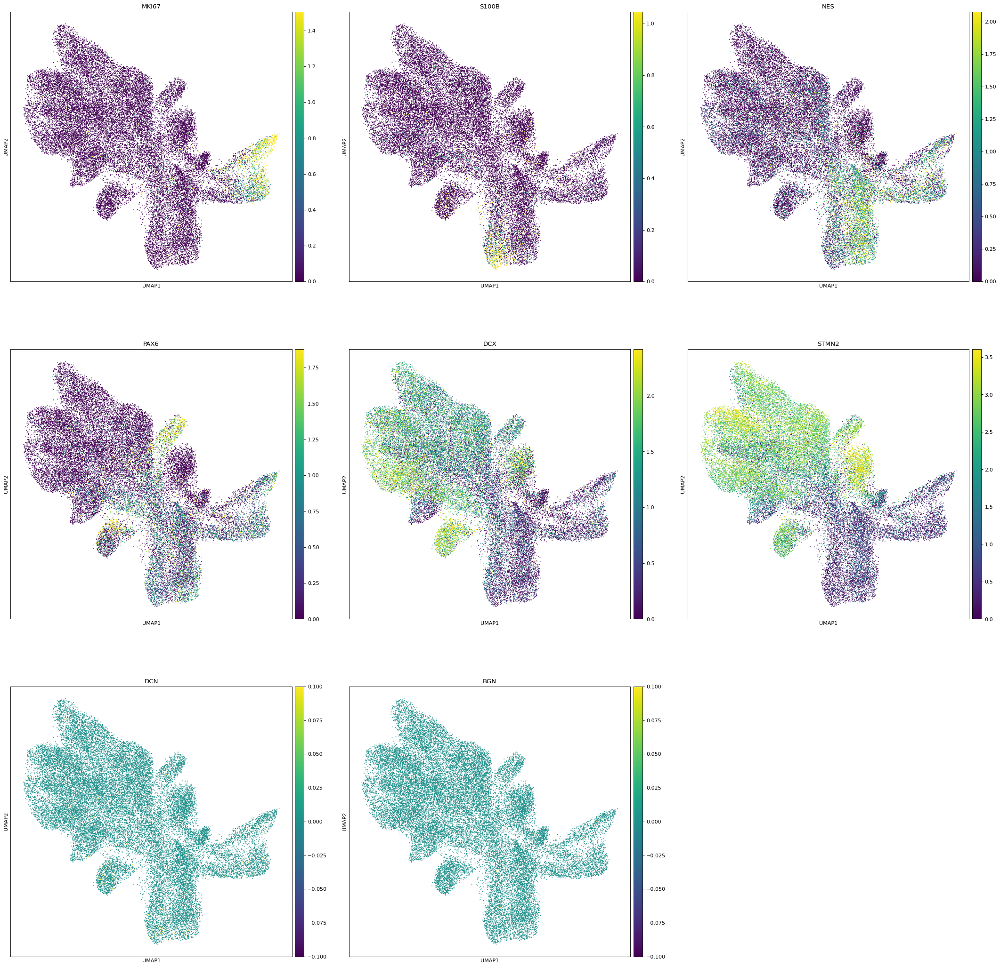

In [33]:
sc.pl.umap(Multiplexing_filt, color=['MKI67', 'S100B',"NES","PAX6","DCX",'STMN2',"DCN", "BGN"],size = 10, ncols=3, vmin='p1.5',vmax='p98.5' )

#### Cell adesion markers

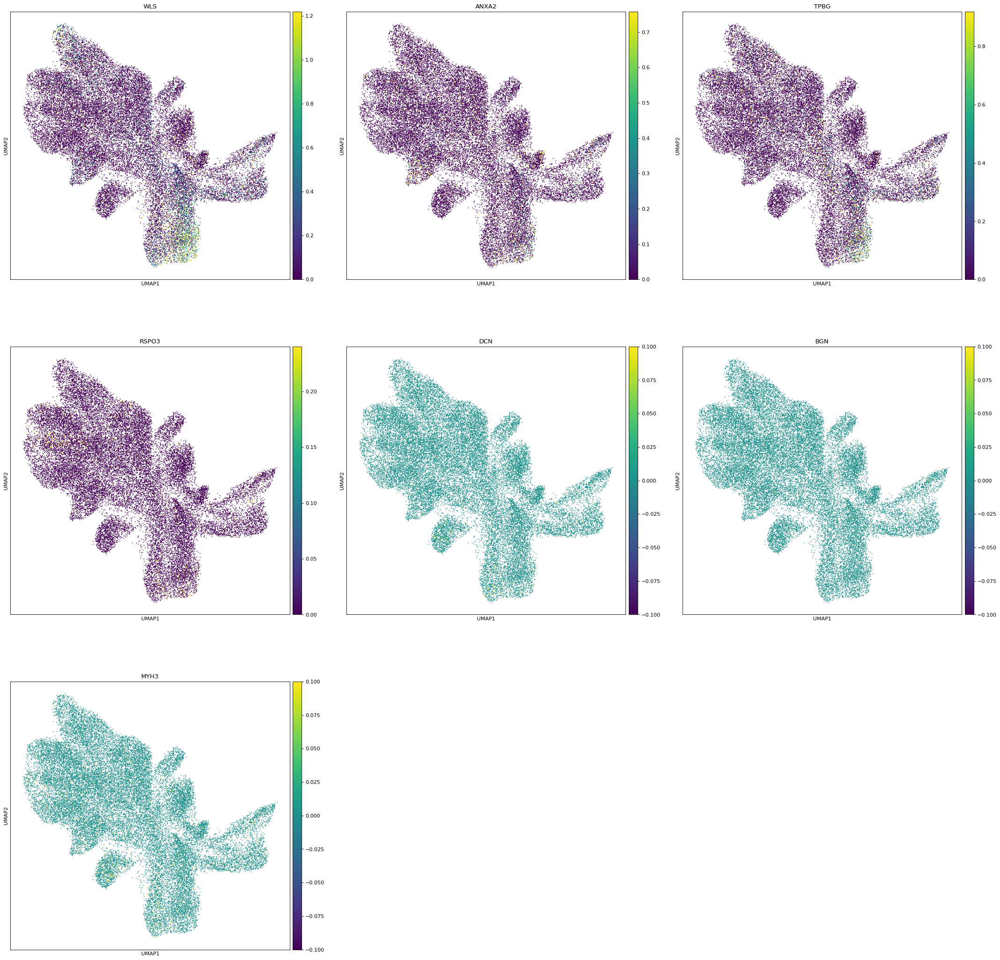

In [34]:
CellAdesion = pd.array(["WLS", "ANXA2","TPBG","RSPO3","DCN","BGN", "MYH3"], dtype="category")

sc.pl.umap(Multiplexing_filt,color= CellAdesion[CellAdesion.isin(Multiplexing.var_names) ],size = 10, ncols=3, vmin='p1.5',vmax='p98.5' )

#### Leiden & IDs

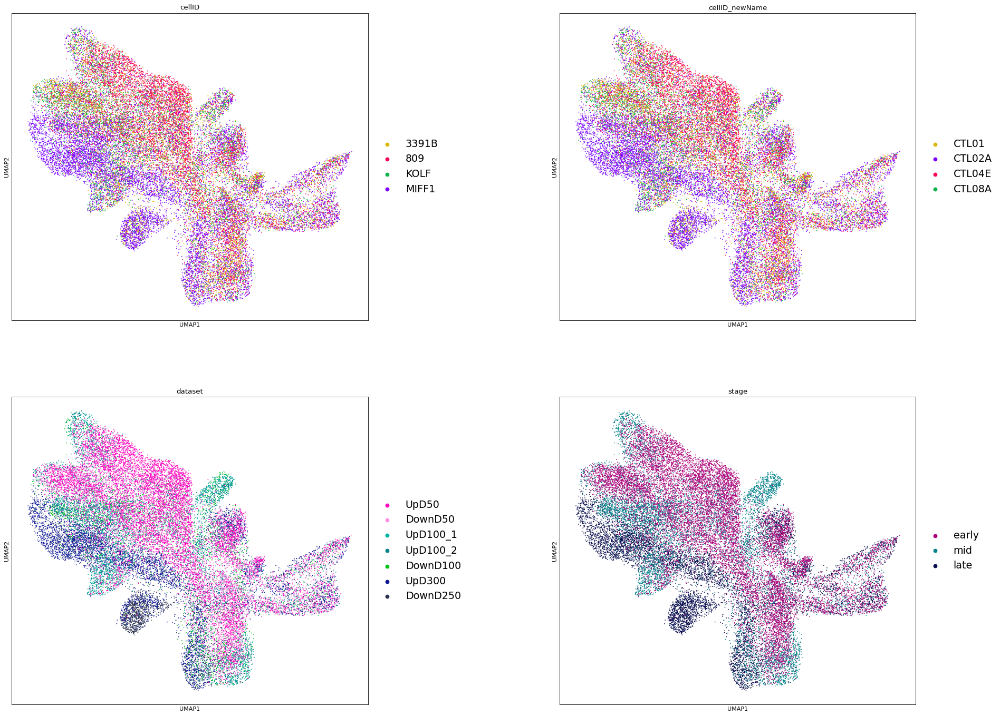

In [38]:
sc.pl.umap(Multiplexing_filt, color=["cellID_newName","dataset","stage"], size = 10, wspace=.4, legend_fontsize = "xx-large", ncols=2)

### Diffmap

In [36]:
sc.tl.diffmap(Multiplexing_filt)

computing Diffusion Maps using n_comps=15(=n_dcs)
computing transitions
    finished (0:00:00)
    eigenvalues of transition matrix
    [1.         0.9934286  0.9896753  0.9788628  0.9754686  0.9717031
     0.97002435 0.9675178  0.9648417  0.961919   0.9521432  0.9501179
     0.94326055 0.9396133  0.93739367]
    finished: added
    'X_diffmap', diffmap coordinates (adata.obsm)
    'diffmap_evals', eigenvalues of transition matrix (adata.uns) (0:00:04)


In [37]:
Multiplexing_filt.write_h5ad(outdir+"/adatas/Integration_Harmony_NoProteoglycan.h5ad")